# Лабораторная работа 3 

  ## Имитация систем непрерывных и дискретных случайных величин

вариант 5

Севрук Елизавета 

гр.853504

In [166]:
import matplotlib.pyplot as plt
import numpy as np
import sympy as sp
import math
import random
from scipy.integrate import quad, dblquad
import scipy.stats as st

### Задание 1. Написать программу, реализующую метод формирования двумерной НСВ с определенным распределением. Выполнить статистическое исследование.

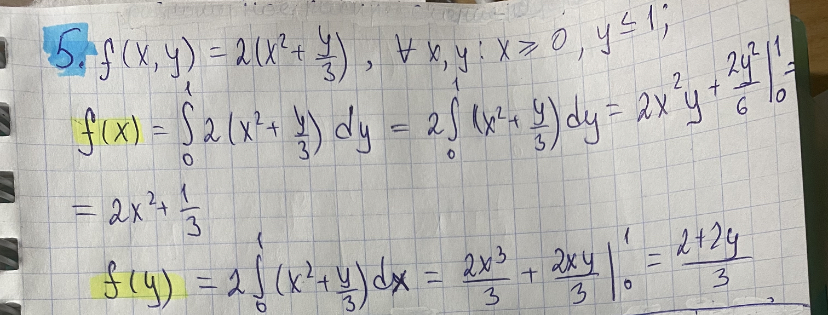

In [167]:
l_bound = 0
r_bound = 1
x,y = sp.symbols('x y')
#Совместная плотность f(x, y) 
f = 2*x**2 + 2*y/3
print("Совместная плотность f(x, y)")
display(f)

Совместная плотность f(x, y)


2*x**2 + 2*y/3

In [168]:
#Одномерные законы распределения (маргинальные плотности распределения)
fx = sp.integrate(f,(y, l_bound, r_bound))  
fy = sp.integrate(f,(x, l_bound, r_bound))
print("Одномерный закон распределения f_x:")
display(fx)
print("Одномерный закон распределения f_x:")
display(fy)

Одномерный закон распределения f_x:


2*x**2 + 1/3

Одномерный закон распределения f_x:


2*y/3 + 2/3

#### Проверка составляющиех двумерной НСВ на независимость. Для того тобы Х и Y были независимыми, необходимо и достаточно, чтобы плотность совместного распределения f(x,y) была равна произведению плотностей распределения составляющих f(x,y) = f(x) * f(y)

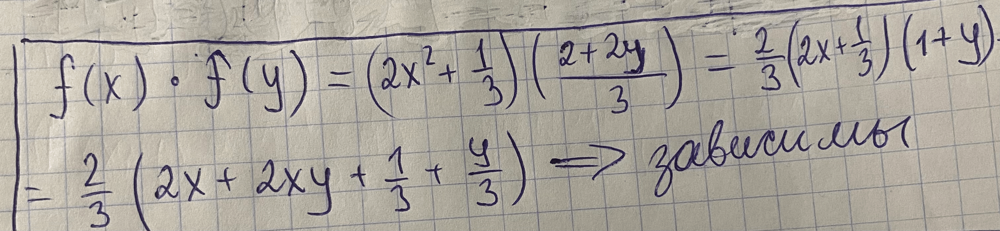

In [169]:
mult = fx * fy
if mult == f:
    print("f(x,y) равное f(x)*f(y) => Х и Y независимыми")
else:
    print("f(x,y) не равное f(x)*f(y) => Х и Y зависимыми")

f(x,y) не равное f(x)*f(y) => Х и Y зависимыми


### Условные плотности распределения

In [170]:
#Условные плотности для непрерывных X и Y
f_xy = f / fy
f_yx = f / fx

print("Условная плотность f(x/y):")
display(f_xy)
print("Условная плотность f(y/x):")
display(f_yx)

Условная плотность f(x/y):


(2*x**2 + 2*y/3)/(2*y/3 + 2/3)

Условная плотность f(y/x):


(2*x**2 + 2*y/3)/(2*x**2 + 1/3)

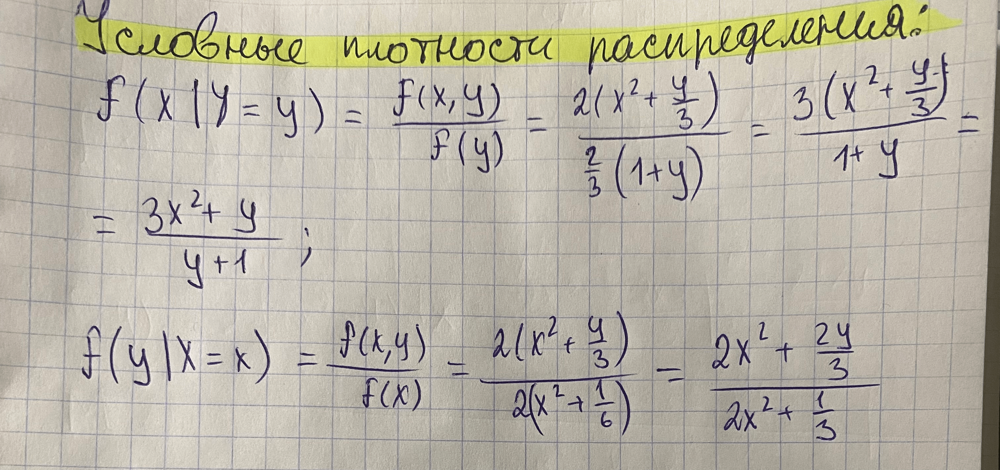

### Построение гистограмм составляющих двумерной НСВ и графиков их плотностей распределения в одной системе координат

In [171]:
def fxy(x, y):
    return 2 * (x**2 + y / 3)
def fx(x):
    return 2 * x**2 + 1 / 3

def fy(y):
    return 2 * y / 3 + 2 / 3

In [172]:
f_max = fxy(1,1)

In [173]:
def neuman_method(N, a, b, f_max):
    x_, y_ = [], []
    for i in range(N):
        while True:
            x, y = a + random.random() * (b - a), a + random.random() * (b - a) 
            z =  random.random() * f_max
            
            if fxy(x, y)> z:
                x_.append(x)
                y_.append(y)
                break 
    return x_, y_

In [174]:
x, y = neuman_method(1000, l_bound, r_bound, f_max)

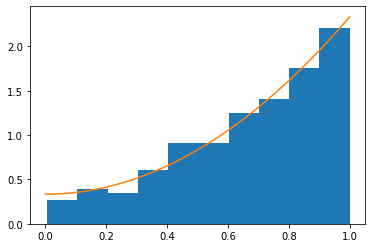

In [175]:
x_ = np.linspace(l_bound, r_bound, 1000)
fx_x = [fx(x_) for x_ in x_]
plt.hist(x, density=True)
plt.plot(x_, fx_x)
plt.show()

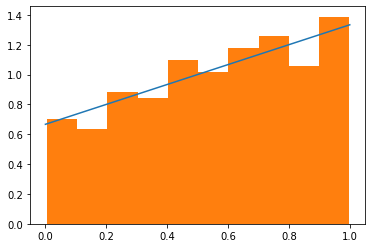

In [176]:
y_ = np.linspace(l_bound, r_bound, 1000)
fy_y = [fy(y_) for y_ in y_]
plt.plot(y_, fy_y)
plt.hist(y, density=True)
plt.show()

#### генерируем случайную величину методом неймана

Метод Неймана является методом, позволяющим получить значения СВ в соответствии с заданным законом распределения. Этот метод является достаточно универсальным он применим для моделирования всех СВ, значения которых не выходят за пределы ограниченного интервала (a,b).

### Вычислить теоретические, точечные и интервальные значения характеристик двумерной НСВ (математическое ожидание, дисперсия, корреляция);

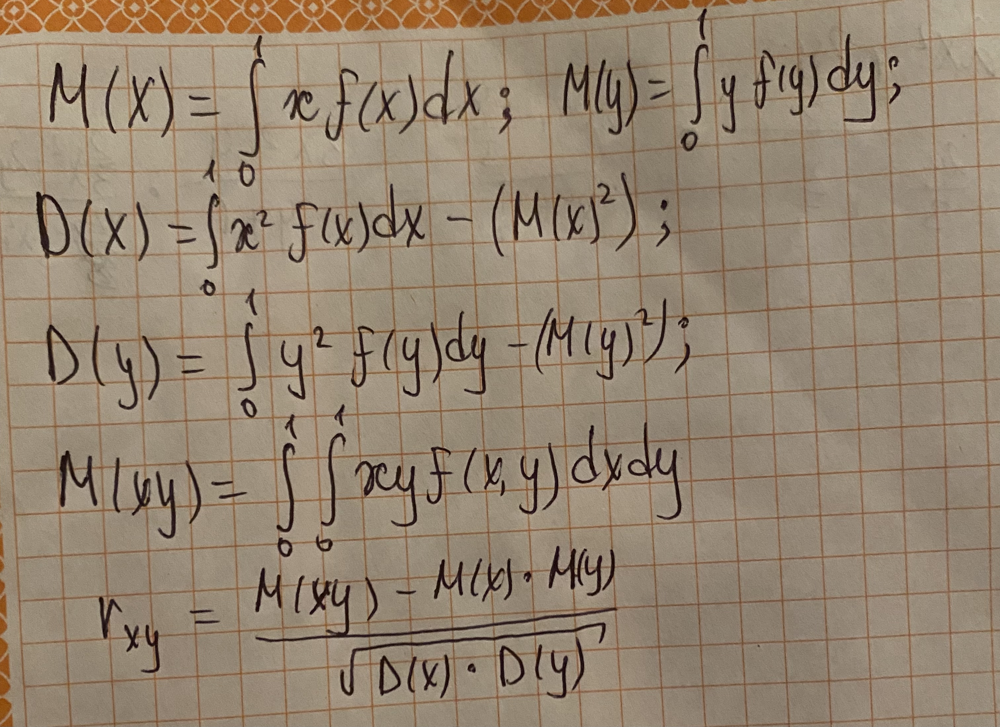

### Теоритические характеристики

In [177]:
def xfx(x):
    return x * fx(x)
def yfy(y):
    return y * fy(y)
def x2fx(x):
    return x ** 2 * fx(x)
def y2fy(y):
    return y ** 2 * fy(y)
def xyfxy(x,y):
    return x * y * fxy(x, y)

In [178]:
Mx = quad(xfx, l_bound, r_bound)[0]
print('Теор. M[x]', Mx)

Теор. M[x] 0.6666666666666666


In [179]:
My = quad(yfy, l_bound, r_bound)[0]
print('Теор. M[y]', My)

Теор. M[y] 0.5555555555555556


In [180]:
Dx = quad(x2fx, l_bound, r_bound)[0] - Mx ** 2
Dy = quad(y2fy, l_bound, r_bound)[0] - My ** 2
print('Теор. D[x]', Dx)
print('Теор. D[y]', Dy)

Теор. D[x] 0.06666666666666676
Теор. D[y] 0.08024691358024694


In [181]:
Mxy = dblquad(xyfxy, l_bound, r_bound, lambda x: l_bound, lambda x: r_bound)[0]
Rxy = (Mxy - Mx * My) / math.sqrt(Dx * Dy)
print('Теор. корреляция', Rxy)

Теор. корреляция -0.12659242088545727


Альтернативная проверка независимости составляющих - так как коэффициент корреляции не равен нулю, то составляющие X и Y являются зависимыми.

### Точечные характеристики

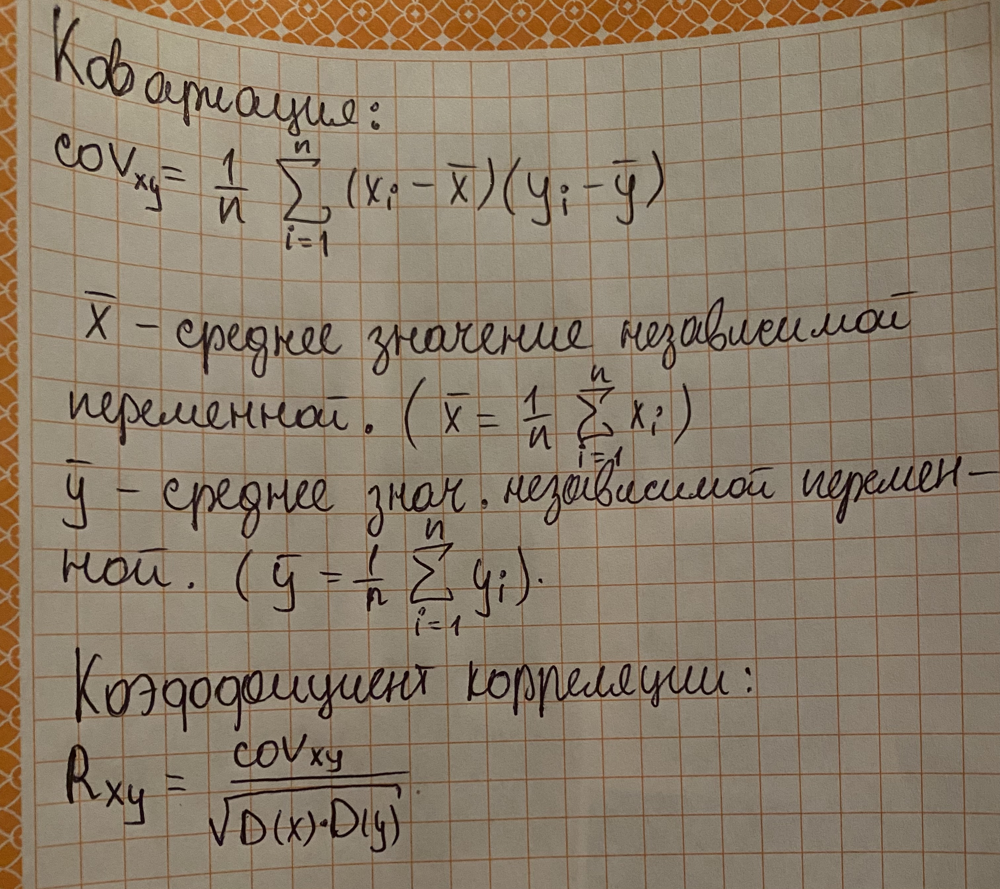

In [248]:
def M(x):
    return sum(x) / len(x)

def D(values, M):
    sum = 0
    for val in values:
        sum += (val - M) ** 2  
    return sum / (len(values))
Mx = M(x)
My = M(y)
print('Точ. M[x]', Mx)
print('Точ. M[y]', My)
print('Точ. D[x]', D(x, M(x)))
print('Точ. D[y]', D(y, M(y)))

def Cov_xy(x, y):
    summ = 0
    for i in range(len(x)):
        summ += (x[i] - M(x)) * (y[i] - M(y))
    return summ/len(x)

Dx = D(x, Mx)
Dy = D(y, My)

def Rxy(x, y):
    cov = Cov_xy(x, y) 
    return cov / math.sqrt(Dx * Dy)
print('Точ. корреляция', Rxy(x, y))

Точ. M[x] 3.0
Точ. M[y] 31.0
Точ. D[x] 2.0
Точ. D[y] 200.0
Точ. корреляция 1.0


### Интервальная оценка

ИНТЕРВАЛЬНАЯ ОЦЕНКА - оценка представляемая интервалом значений, внутри которого с задаваемой исследователем вероятностью находится истинное значение оцениваемого параметра. Интервал в интервальной оценке называется ДОВЕРИТЕЛЬНЫМ ИНТЕРВАЛОМ, задаваемая исследователем вероятность называется ДОВЕРИТЕЛЬНОЙ ВЕРОЯТНОСТЬЮ. В практике статистических вычислений применяются стандартные значения доверительной вероятности: 0,95, 0,98 и 0,99 (95%, 98% и 99% соответственно). 

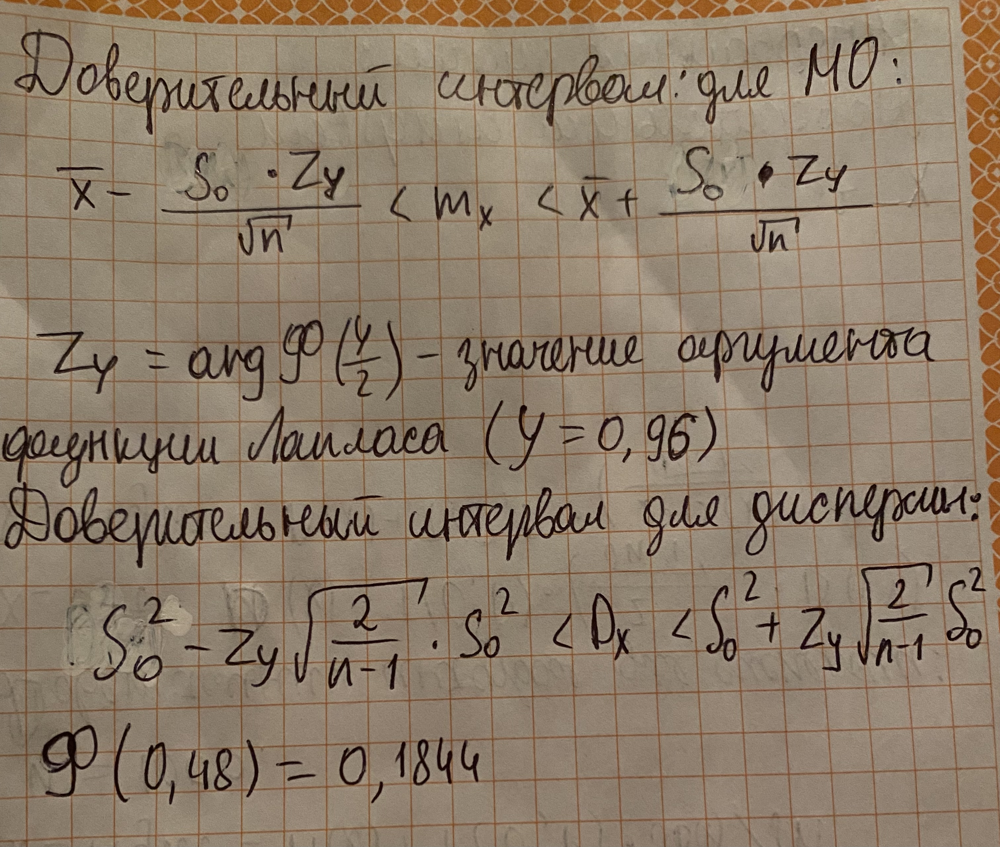

In [201]:
n = 1000
x_left = M(x) - 1.1844 * Dx / n**0.5
x_right = M(x) + 1.1844 * Dx / n**0.5
print('(',x_left, x_right,')')

( 0.6707913773460724 0.6755259770463652 )


In [202]:
y_left = M(y) - 1.1844 * Dy / n**0.5
y_right = M(y) + 1.1844 * Dy / n**0.5
print('(',y_left, y_right,')')

( 0.5584002070789362 0.5641644204232972 )


Доверительный интервал для дисперсии

In [213]:
Dx_left = Dx - 1.1844 * (2 / (n - 1))**0.5 * Dx 
Dx_right = Dx + 1.1844 * (2 / (n - 1))**0.5 * Dx
print('(',Dx_left, Dx_right,')')

( 0.05985595734863758 0.06655504283774832 )


In [206]:
Dy_left = Dy - 1.1844 * (2 / (n - 1))**0.5 * Dy
Dy_right = Dy + 1.1844 * (2 / (n - 1))**0.5 * Dy
print('(',Dy_left, Dy_right,')')

( 0.07287258267413634 0.08102849033597313 )


In [221]:
def z_to_r(z):
#'''Преобразование z-оценки обратно в r-значение'''
    return (np.exp(z*2) - 1) / (np.exp(z*2) + 1)

def interval(x,y, alpha):
    r = st.pearsonr(x,y)[0]
    zr = 0.5 * np.log((1 + r) / (1 - r)) 
    crit = st.norm.ppf(1-alpha/2)
    sez = 1 / np.sqrt(len(x) - 3)
    return (z_to_r(zr - (crit * sez))), (z_to_r(zr + (crit * sez)))

print(f'Доверительный интервал для коэф. корреляции: {interval(x, y, 0.04)}')

Доверительный интервал для коэф. корреляции: (-0.18000112206139912, -0.051851542876513786)


## Задание 2. Написать программу, реализующую метод формирования двумерной ДСВ. Матрицу распределения ДСВ задаете самостоятельно. Выполнить статистическое исследование.

### Матрица распределения ДСВ и векторы возможных значений компонент X и Y


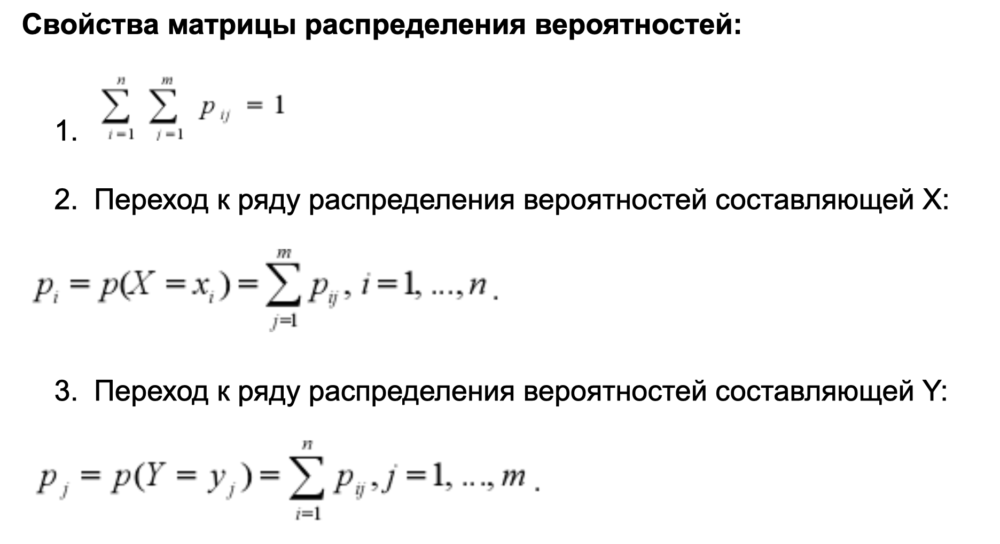

In [330]:
import csv
#матрица распределения ДСВ берётся из файла input.csv
with open('input.csv', newline='') as csvfile:
    data = list(csv.reader(csvfile))
#из считанного файла выгружаем данные в массив probabilitiesXY
probabilitiesXY = []
for line in data:
    for element in line:
        elements = element.split(';')
        new_el = []
        for el in elements:
            new_el.append(float(el))

        probabilitiesXY.append(new_el)
# Устанавливаем проверку на свойство матрицы №1 
# если сумма != 1, то матрица неверная 
print(np.sum(probabilitiesXY))
if round(np.sum(probabilitiesXY), 3) != 1.000: 
    print("Матрица распределения ДСВ задана неверно! Дальнейшая работа невозможна")
else: print("Матрица распределения ДСВ задана успешно! Продолжаем работу")


1.0000000000000002
Матрица распределения ДСВ задана успешно! Продолжаем работу


In [331]:
#Задаём Х и Y
valuesX = [i for i in range(1, len(probabilitiesXY) + 1)]
valuesY = [i + valuesX[-1] for i in range(1, len(probabilitiesXY[0]) + 1)]
print(valuesX, valuesY)
n = len(valuesX)
m = len(valuesY)
valuesXY = []
valuesXY.append(valuesX)
valuesXY.append(valuesY)
print(valuesXY)
# Переход к ряду распределения вероятностей составляющей X 
#(второй пункт из свойств матрицы распределения вероятностей):
p_x = [np.sum(probabilitiesXY[i]) for i in range(len(probabilitiesXY))]
# Переход к ряду распределения вероятностей составляющей Y 
#(третий пункт из свойств матрицы распределения вероятностей):
p_y = [np.sum(probabilitiesXY[:][0]) for i in range(1, len(probabilitiesXY[0]))]
print("p_x", p_x, "\np_y", p_y)

[1, 2, 3] [4, 5, 6, 7]
[[1, 2, 3], [4, 5, 6, 7]]
p_x [0.3400000000000001, 0.28500000000000003, 0.375] 
p_y [0.3400000000000001, 0.3400000000000001, 0.3400000000000001]


### Проверить составляющие двумерной ДСВ на независимость

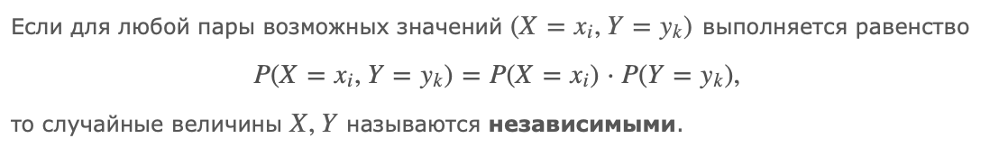

In [332]:
def independence_test(P, n, m):  
    for i in range(n):
        for j in range(m):
            if P[i][j] != p_x[i]*p_y[j]:
                print('X,Y зависимы')
                print(f'P[{i}][{j}] != p_x[{i}]*p_y[{j}]')
                print(f'{P[i][j]} != {p_x[i]*p_y[j]}')
                return
    print('X,Y независимы')
independence_test(P, n,m)

X,Y зависимы
P[0][0] != p_x[0]*p_y[0]
0.03 != 0.11560000000000005


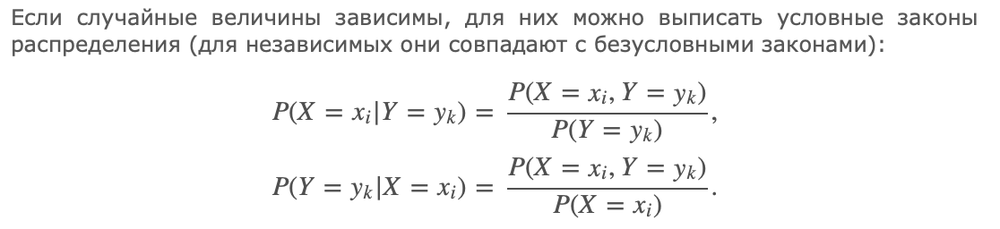

### Находим условные плотности распределения

In [333]:
p_xy = np.copy(P)

for i in range(n):
    for j in range(m):
        p_xy[i][j] /= p_y[i]  
        
print("P(X|Y)\n",p_xy)

p_yx = np.copy(P)
for i in range(n):
    for j in range(m):
        p_yx[i][j] /= p_x[i]

print("P(Y|X)\n",p_yx)

P(X|Y)
 [[0.08823529 0.05882353 0.20588235 0.02941176 0.09      ]
 [0.32352941 0.23529412 0.14705882 0.29411765 0.02      ]
 [0.14705882 0.08823529 0.02941176 0.02941176 0.06      ]
 [0.03       0.02       0.01       0.02       0.04      ]
 [0.01       0.02       0.03       0.02       0.06      ]]
P(Y|X)
 [[0.08823529 0.05882353 0.20588235 0.02941176 0.09      ]
 [0.38596491 0.28070175 0.1754386  0.35087719 0.02      ]
 [0.13333333 0.08       0.02666667 0.02666667 0.06      ]
 [0.03       0.02       0.01       0.02       0.04      ]
 [0.01       0.02       0.03       0.02       0.06      ]]


### Функция распределения составляющей X:

In [334]:
def F_x(n, m, DSV_matrix, p_x):
    F, summ = [], 0
    for i in range(n):
        summ += p_x[i]
        F.append(summ)
    return F

F_x = F_x(n, m, DSV_matrix, p_x)
print('F_x = ', F_x)

F_x =  [0.3400000000000001, 0.6250000000000001, 1.0]


### Функции распределения составляющей Y:

In [335]:
def F_yx(n, m, DSV_matrix, p_x):
    F_yx = [[0] * m for i in range(n)]
    for i in range(n):
        summ = 0
        for j in range(m):
            summ += DSV_matrix[i][j]
            F_yx[i][j] = summ / p_x[i]
    return F_yx

F_yx = F_yx(n, m, DSV_matrix, p_x)
F_yx

[[0.588235294117647, 0.8823529411764706, 0.9852941176470588, 1.0],
 [0.08771929824561403, 0.43859649122807015, 0.49122807017543857, 1.0],
 [0.06666666666666667, 0.20000000000000004, 0.7333333333333334, 1.0]]

### Формирование списка значений компоненты X:


In [336]:
def generate_X(n, F_x, N):
    f_x_bounds = [0] * (n+1)
    for i in range (n):
        f_x_bounds[i+1] = F_x[i]

    x_list = []
    for i in range(N):
        x_val = random.random()
        for k in range(n):
            if x_val > f_x_bounds[k] and x_val <= f_x_bounds[k+1]:
                x_list.append(k)
    return x_list

In [337]:
x_list = generate_X(n, F_x, 1000)

### Формирование списка значений компоненты Y:

In [338]:
def generate_Y(m, F_yx, x_list):
    y_list = []
    for x_i in x_list:
        f_yx_bounds = [0] * (m+1)
        for i in range(m):
            f_yx_bounds[i+1] = F_yx[x_i][i]
            
        y_val = random.random()
        for s in range(m):
            if y_val > f_yx_bounds[s] and y_val <= f_yx_bounds[s+1]:
                y_list.append(s)
    return y_list

In [339]:
y_list = generate_Y(m, F_yx, x_list)

### Построение гистограмм составляющих двумерной ДСВ 

Одномерный ряд P(x):  [0.3400000000000001, 0.28500000000000003, 0.375]
Одномерный ряд P(y):  [0.3400000000000001, 0.3400000000000001, 0.3400000000000001]


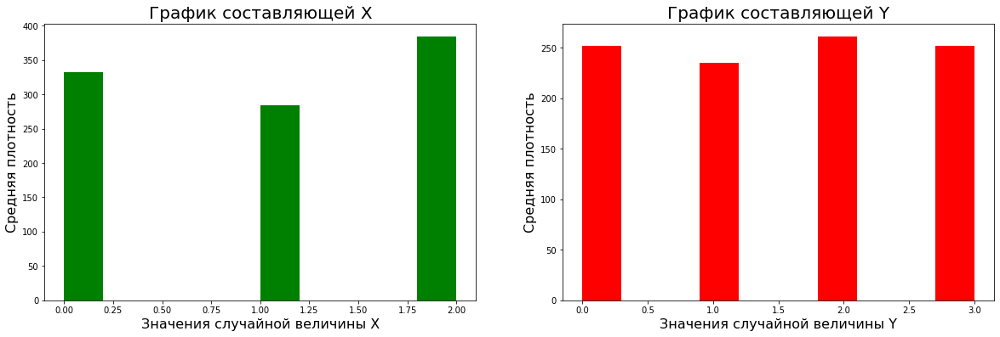

In [340]:
fig, ax = plt.subplots(1,2)
fig.set_figwidth(20)   
fig.set_figheight(6) 

ax[0].hist(x_list, bins=10, color='green')
ax[0].set_title('График составляющей X', {'fontsize': 20})
ax[0].set_ylabel('Средняя плотность', {'fontsize': 16})
ax[0].set_xlabel('Значения случайной величины X', {'fontsize': 16})

ax[1].hist(y_list, bins=10, color='red')
ax[1].set_title('График составляющей Y', {'fontsize': 20})
ax[1].set_ylabel('Средняя плотность', {'fontsize': 16})
ax[1].set_xlabel('Значения случайной величины Y', {'fontsize': 16})

print("Одномерный ряд P(x): ", p_x)
print("Одномерный ряд P(y): ", p_y)

### Числовые (теоретические) характеристики


In [341]:
def M(X, p_x):
    m_x = 0
    for i in range(len(p_x)):
        m_x += p_x[i] * X[i]
    return m_x

def D(X, p_x, m_x):
    d_sum = 0
    for i in range(len(p_x)):
        d_sum += p_x[i]*(X[i]**2)
    return d_sum - (m_x**2)

def R(X, Y, m_x, m_y, matrix, n, m):
    m_xy = 0
    for i in range(n):
        for j in range(m):
            m_xy += X[i]*Y[j]*matrix[i][j]
    return m_xy - (m_x * m_y)

In [342]:
M_x = M(X, p_x)
M_y = M(Y, p_y)
D_x = D(X, p_x, M_x)
D_y = D(Y, p_y, M_y)
R_xy = R(X, Y, M_x, M_y, DSV_matrix, n, m) /  (math.sqrt(D_x) * math.sqrt(D_y)) 
print("Математическое ожидание M[x]:", float(M_x))
print("Математическое ожидание M[y]:", float(M_y))
print("Дисперсия D[x]:", float(D_x))
print("Дисперсия D[y]:", float(D_y))
print("Коэффициент корреляции R[xy]:", float(R_xy))

Математическое ожидание M[x]: 1.0350000000000001
Математическое ожидание M[y]: 1.0200000000000002
Дисперсия D[x]: 0.7137749999999998
Дисперсия D[y]: 0.6596
Коэффициент корреляции R[xy]: 1.4709546497242616


### Точечные характеристики


In [344]:
def M_point(x_val, N):
    summ = 0
    for i in range(N):
        summ += x_val[i]
    return summ / N

def D_point(x_val, m_x, N): 
    summ = 0
    for i in range(N):
        summ += (x_val[i] - m_x)**2
    return summ / (N - 1)

def K_point(x_val, y_val, m_x, m_y, N):
    summ = 0
    for i in range(N):
        summ += (x_val[i] - m_x)*(y_val[i] - m_y)
    return summ / (N - 1)

N = 1000
print("Точечные значения:")

m_x_point, m_y_point = M_point(x_list, N), M_point(y_list, N)
print("\nМатематическое ожидание M[x]:", m_x_point)
print("Математическое ожидание M[y]:", m_y_point)

d_x_point, d_y_point = D_point(x_list, m_x_point, N), D_point(y_list, m_y_point, N)
print("\nДисперсия D[x]:", d_x_point)
print("Дисперсия D[y]:", d_y_point)

r_xy_point = R_point(x_list, y_list, m_x_point, m_y_point, N) /  (math.sqrt(d_x_point) * math.sqrt(d_y_point)) 
print("\nКоэффициент корреляции R[xy]:", r_xy_point)

Точечные значения:

Математическое ожидание M[x]: 1.052
Математическое ожидание M[y]: 1.513

Дисперсия D[x]: 0.7140100100100067
Дисперсия D[y]: 1.2590900900900848

Коэффициент корреляции R[xy]: 0.5725491613098892


### Интервальная оценка


In [352]:
def M_intervals(x_val, m_x, d_x, N, confidence_level = 0.95):
    normal_quantil = st.norm.ppf(confidence_level)
    return [m_x - np.sqrt(d_x / N) * normal_quantil, m_x + np.sqrt(d_x / N) * normal_quantil]

def D_intervals(x_val, d_x, N, confidence_level = 0.95):
    chi_mass = st.chi2(N - 1)
    array = chi_mass.rvs(N)
    quantiles = st.mstats.mquantiles(array, prob = [(1 - confidence_level)/2, (1 + confidence_level)/2])
    xi_plus, xi_minus = quantiles[0], quantiles[1]
    return ((N - 1) * d_x / xi_minus, (N - 1) * d_x / xi_plus)

In [353]:
M_x_intervals = M_intervals(x_list, m_x_point, d_x_point, N, confidence_level = 0.95)
print('Доверительный интервал для оценки математического ожидания X: ', M_x_intervals)
M_y_intervals = M_intervals(y_list, m_y_point, d_y_point, N, confidence_level = 0.95)
print('Доверительный интервал для оценки математического ожидания Y: ', M_y_intervals)
D_x_intervals = D_intervals(x_list, d_x_point, N, confidence_level = 0.95)
print('\nДоверительный интервал для оценки дисперсии X: ', D_x_intervals)
D_y_intervals = D_intervals(y_list, d_y_point, N, confidence_level = 0.95)
print('Доверительный интервал для оценки дисперсии Y: ', D_y_intervals)

Доверительный интервал для оценки математического ожидания X:  [1.0080479225890155, 1.0959520774109845]
Доверительный интервал для оценки математического ожидания Y:  [1.4546345740068691, 1.5713654259931307]

Доверительный интервал для оценки дисперсии X:  (0.6553504200590391, 0.7807738612336776)
Доверительный интервал для оценки дисперсии Y:  (1.153740317210409, 1.3695129141821387)


### Альтернативная проверка независимости составляющих:

In [354]:
print("Коэффициент корреляции R[xy]:", float(R_xy))

Коэффициент корреляции R[xy]: 1.4709546497242616


##### Так как коэффициент корреляции не равен нулю, то составляющие X и Y являются зависимыми.